# Google Landmark Recognition 2020 (Data wrangling and story telling)

The landmark recognition problem is among the primary tasks handled in computer vision. Landmark image recognition can be used in tourist guide applications. These days, tourists can capture and upload picture of any place using their smartphone and get interesting information about the place such as the name and its history. Moreover, landmark recognition can help people to organize their photo files by recognizing the landmark in the photo. Considering that a lot of pictures are taken during a vacation and people usually forget the name of the place that they have visited, landmark recognition can be very useful. 

In [1]:
import os
import pathlib

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

import glob

import PIL
import tensorflow as tf
from tqdm import tqdm
from PIL import Image, ImageDraw, ImageFont
from six import BytesIO
from tensorflow import keras
from tensorflow.keras import applications
from tensorflow.keras.models import Sequential,Model,load_model
from tensorflow.keras import datasets, layers
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Load data and first checks:

First load the dataset into a dataframe and add the path of each image as a new column ('path').

In [2]:
def read_data_file(input_path):
    files_paths = glob.glob(input_path + 'train/*/*/*/*')
    # Map image path to the image id
    mapping = {}
    for path in files_paths:
        mapping[path.split('/')[-1].split('.')[0]] = path
    df = pd.read_csv(input_path + 'train.csv')
    # Add path as a new column 
    df['path'] = df['id'].map(mapping, na_action='ignore')

    return df

In [3]:
df = read_data_file('/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/')

In [4]:
df

,id,landmark_id,path
0,17660ef415d37059,1,NaN
1,92b6290d571448f6,1,NaN
2,cd41bf948edc0340,1,NaN
3,fb09f1e98c6d2f70,1,NaN
4,25c9dfc7ea69838d,7,NaN
...,...,...,...
1580465,72c3b1c367e3d559,203092,NaN
1580466,7a6a2d9ea92684a6,203092,NaN
1580467,9401fad4c497e1f9,203092,NaN
1580468,aacc960c9a228b5f,203092,NaN


Remove the NaN values from the dataset.

In [5]:
df = df.dropna()

In [6]:
df

,id,landmark_id,path
12,0193b65bb58d2c77,9,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
50,0a199c97c382b1ff,12,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
78,0be5d581f54d3116,22,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
119,00cba0067c078490,27,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
120,00f928e383e1d121,27,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
...,...,...,...
1580273,0bbd902d9138064b,203071,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
1580274,0dbd550c63a1d443,203071,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
1580386,08670acbc212fc03,203080,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...
1580440,0926becdb2c92f8a,203085,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...


Let's check for any missing values in the data.

In [7]:
df.isnull().count()

id             98637
landmark_id    98637
path           98637
dtype: int64

Complete the dataframe by groupby landmark to see how many class lablels ('label') are exist and their occurence ('counts'). 

In [8]:
def complete_dataframe(df):
    # Add a new column that shows how many times an image is repeated
    counts_map = dict(df.groupby('landmark_id')['path'].agg(lambda x: len(x)))
    df['counts'] = df['landmark_id'].map(counts_map)
    
    # Add a new column for labeling landmark_id   
    unique_landmark_ids = df['landmark_id'].unique()
    df['label'] = df['landmark_id'].map(dict(zip(unique_landmark_ids, range(len(unique_landmark_ids)))))
    
    return df, dict(zip(range(len(unique_landmark_ids)), unique_landmark_ids))

In [9]:
completed_df, mapping = complete_dataframe(df)

/Users/mehrnaz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/Users/mehrnaz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [10]:
completed_df

,id,landmark_id,path,counts,label
12,0193b65bb58d2c77,9,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,1,0
50,0a199c97c382b1ff,12,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,1,1
78,0be5d581f54d3116,22,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,1,2
119,00cba0067c078490,27,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,32,3
120,00f928e383e1d121,27,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,32,3
...,...,...,...,...,...
1580273,0bbd902d9138064b,203071,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,3,40951
1580274,0dbd550c63a1d443,203071,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,3,40951
1580386,08670acbc212fc03,203080,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,1,40952
1580440,0926becdb2c92f8a,203085,/Users/mehrnaz/Desktop/SpringBoard/Assignment/...,1,40953


# Storytelling ( Data Visualization):

Lets look at the landmark_id distribution and its histogram at the same time

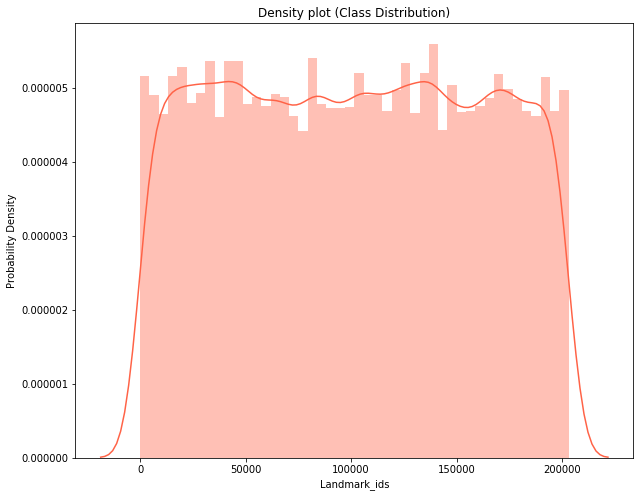

In [11]:
#Landmark ID distribution
plt.figure(figsize = (10, 8))
plt.title('Landmark ID Distribuition')
sns.distplot(completed_df['landmark_id'], color="tomato")
plt.xlabel("Landmark_ids")
plt.ylabel("Probability Density")
plt.title('Density plot (Class Distribution)')
plt.show()

In [12]:
# Landmark Id Density Plot
#plt.figure(figsize = (8, 8))
#plt.title('Landmark id density plot')
#sns.kdeplot(completed_df['landmark_id'], color="green", shade=True,  clip=(0,98637))
#plt.xlabel("Landmark_ids")
#plt.ylabel("Probability Density")
#plt.title('Density plot(Class Distribution)')
#plt.show()

Let's check the top 10 class categories

In [13]:
completed_df['landmark_id'].unique()

array([     9,     12,     22, ..., 203080, 203085, 203092])

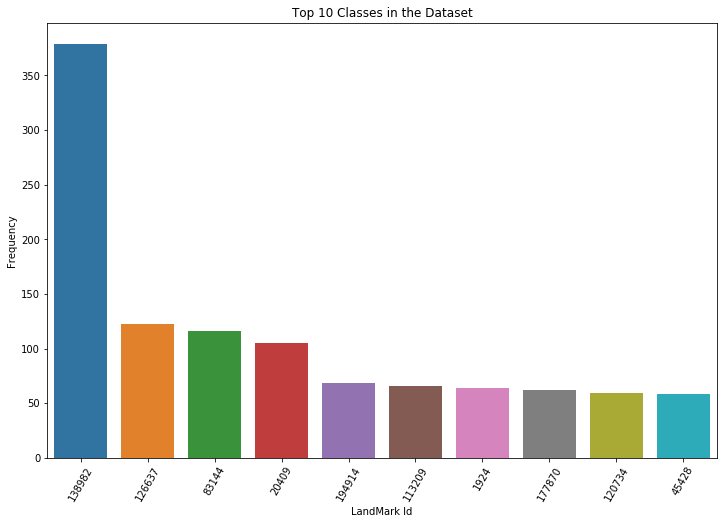

In [14]:
plt.figure(figsize = (12, 8))
sns.countplot(x=completed_df['landmark_id'], order = completed_df['landmark_id'].value_counts().sort_values(ascending=False).iloc[0:10].index)
#sns.countplot(x=completed_df['landmark_id'].unique()[:10])
#sns.countplot(x='landmark_id', palette="ch:.25", data=completed_df)
plt.xticks(rotation = 60)
plt.xlabel("LandMark Id")
plt.ylabel("Frequency")
plt.title("Top 10 Classes in the Dataset")

plt.show()

Let's check the bottom 10 class categories

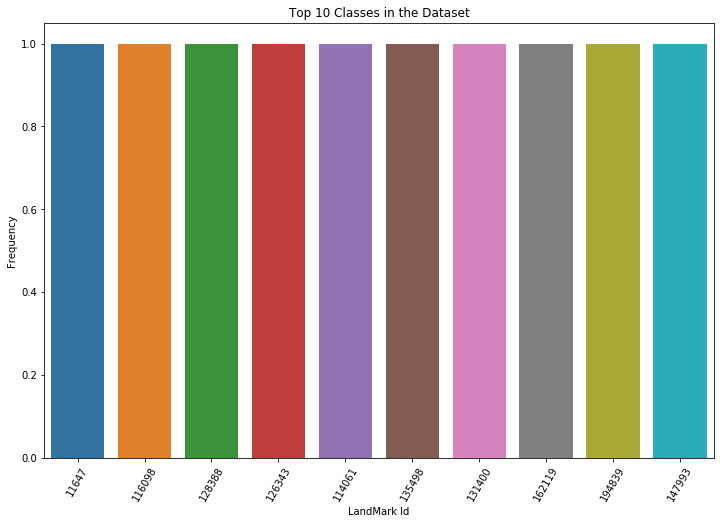

In [15]:
plt.figure(figsize = (12, 8))
sns.countplot(x=completed_df['landmark_id'], order = completed_df['landmark_id'].value_counts().sort_values(ascending=False).iloc[-10:].index)
#sns.countplot(x=completed_df['landmark_id'].unique()[:10])
#sns.countplot(x='landmark_id', palette="ch:.25", data=completed_df)
plt.xticks(rotation = 60)
plt.xlabel("LandMark Id")
plt.ylabel("Frequency")
plt.title("Top 10 Classes in the Dataset")

plt.show()

Let see the number of classes with less than 30 occurrence

In [31]:
print("There are {} classes with less than 30 occurrences" .format((completed_df['landmark_id'].value_counts()<=30).sum()), 'from {} total class categories' .format(completed_df['label'].max()))

There are 40901 classes with less than 30 occurrences from 40954 total class categories


<Figure size 864x576 with 0 Axes>

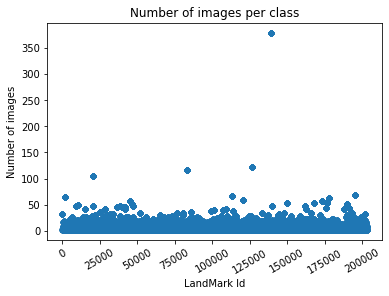

In [17]:
# Number of images per class labels
plt.figure(figsize = (12, 8))
completed_df.plot.scatter(x='landmark_id', y='counts',title='Number of images per class')
locs, labels = plt.xticks()
plt.setp(labels, rotation=30)
plt.xlabel("LandMark Id")
plt.ylabel("Number of images")
plt.show()

## Read and resize all the images to have a same shape

In [18]:
def read_image_resize_rescale(path):
    # Reads and outputs the entire path
    image = tf.io.read_file(path)
    # Decode a JPEG-encoded image to a uint8 tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Resize all the images to be in shape of (800, 600, 3)
    input_size = (256, 256, 3)
    image = tf.image.resize(image, input_size[0:2], method='bilinear')
    
    # image is an object of the tensorflow.python.framework.ops.EagerTensor class
    
    # The numpy() method converts the image object to a numpy array
    image_rescaled = image.numpy() / 255.0
    return image_rescaled

In [19]:
def load_image_into_numpy_array(path, max_height_max_width_list):
    """Load an image from file into a numpy array.
    
    Puts image into numpy array to feed into tensorflow graph.
    Note that by conversion we put it into a numpy array with shape (height, width, channels),
    where channels=3 for RGB.
    
    Args:
        path: a file path.
        max_height_max_width_list: a list of max_height and max_width
    Returns:
        uint8 numpy array with shape (img_height, img_width, 3)
    """
    
    # Getting image data from image path
    img_data = tf.io.gfile.GFile(path, 'rb').read()
    # Create an image from binary data
    image = Image.open(BytesIO(img_data))
    (im_width, im_height) = image.size
    # Find the maximum height and width
    if im_width > max_height_max_width_list[1]:
        max_height_max_width_list[1] = im_width
    if im_height > max_height_max_width_list[0]:
        max_height_max_width_list[0] = im_height
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

## Show images from top 10 landmark_id (classes)

In [20]:
top10_classes = completed_df['landmark_id'].value_counts().sort_values(ascending=False).iloc[:10].index
type(top10_classes)
top10_classes

path_image_of_top10 = []

for i in top10_classes:
    #completed_df.loc[completed_df.landmark_id == i].index.values  
    path_image = completed_df[completed_df.landmark_id == i].iloc[0]['path']
    path_image_of_top10.append(path_image)
    
path_image_of_top10   

['/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/0/0006f34cf361f69c.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/0/000b0d1da1f48a3f.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/0/000d9bf37257daff.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/4/004d531bd0f43001.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/1/0010c0d17669f608.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/0/000a0629daeb87ba.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Capstone_2_Landmark_Recognition/train/0/0/0/00061e23ce736fa9.jpg',
 '/Users/mehrnaz/Desktop/SpringBoard/Assignment/Capstone_Projects/Cap

In [21]:
plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [200, 100]

max_height_max_width_list = [0, 0]

display_top10_5images = []

for path in path_image_of_top10:
    display_top10_5images.append(load_image_into_numpy_array(path, max_height_max_width_list))
for idx, display_5images in enumerate(display_top10_5images):
    plt.subplot(2,5,idx+1)
    plt.imshow(display_5images)
plt.show()

In [22]:
plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [200, 100]

max_height_max_width_list = [0, 0]
display_images_np = []
for path in completed_df.iloc[21:31]['path']:
    display_images_np.append(load_image_into_numpy_array(path, max_height_max_width_list))
for idx, display_image_np in enumerate(display_images_np):
    plt.subplot(2,5,idx+1)
    plt.imshow(display_image_np)
plt.show()

In [23]:
top10_classes = completed_df['landmark_id'].value_counts().sort_values(ascending=False).iloc[:10].index
top10_classes

Int64Index([138982, 126637, 83144, 20409, 194914, 113209, 1924, 177870, 120734,
            45428],
           dtype='int64')

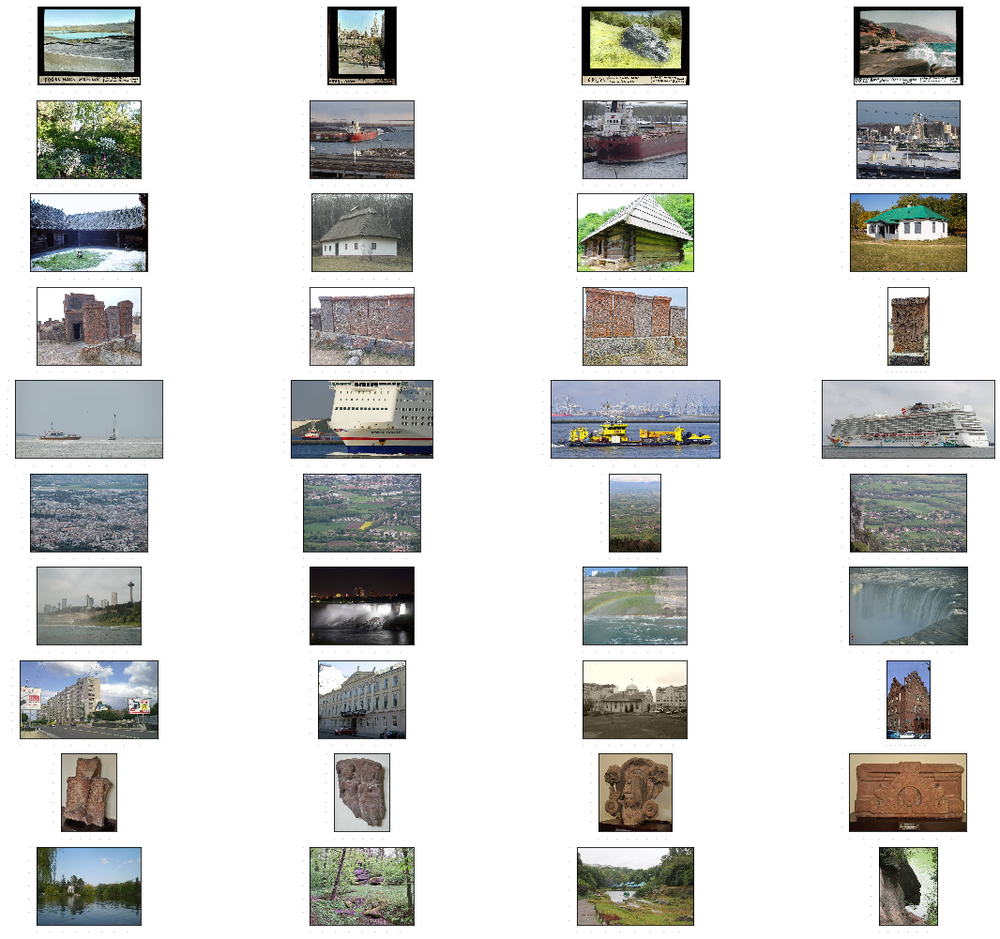

In [24]:
top10_classes = completed_df['landmark_id'].value_counts().sort_values(ascending=False).iloc[:10].index
top10_classes

max_height_max_width_list = [0, 0]
path_images = []
for i in range(10):
    for j in range(4):
        #completed_df.loc[completed_df.landmark_id == i].index.values  
        path_image = completed_df[completed_df.landmark_id == top10_classes[i]].iloc[j]['path']
        path_images.append(load_image_into_numpy_array(path_image, max_height_max_width_list))
plt.figure(figsize = (20, 18))        
for idx, path_image in enumerate(path_images):
    plt.subplot(10,4,idx+1)
    plt.imshow(path_image)
#plt.show()